In [112]:
import numpy as np
import  utils
import matplotlib.pyplot as plt
from math import exp, sqrt
from scipy.signal import lfilter
from scipy.stats import  norm
from scipy.optimize import root as root_finder
import matplotlib.animation as animation
import time
from IPython.display import  HTML
from    tqdm                                        import  tqdm

In [113]:
# 1/24 = 1 week. 1Y = 6M | 1M = 4W --> 1Y = 24W
# 1/240 = 1/2 bday. 1W = 5 bdays
k, sigma, T, delta, dt  = 0.015, 0.025, 5, 1/24, 1/240 #sigma = 0.01 0.025
C1, C2, C3              = 0.15, -0.03, -0.18 # C1 = 0.05 0.15
r0                      = utils.obs_yield_curve(0, C1, C2, C3)
notional                = 10000

time_grid   = np.arange(0, T+dt, dt)
dfixing     = 0.25
fixing_grid = np.arange(T+dfixing, T+5+dfixing, dfixing)
N           = len(time_grid)-1
M           = 10000
tref        = 1 # 1/12 : 1 month
ind_tref, ind_delta, ind_tdelta = int(tref/dt), int(delta/dt), int((tref+delta)/dt)
alpha       = 0.99
R           = 0.04

In [114]:
rf_paths = utils.gen_riskfactors(r0, k, sigma, C1, C2, C3, dt, M, time_grid)

In [115]:
zc1_mtm_paths = utils.gen_zc_mtm(rf_paths, k, sigma, C1, C2, C3, T, time_grid)

In [116]:
swaption_mtm_paths = utils.gen_mtm(rf_paths, k, sigma, R, C1, C2, C3, dt, T, time_grid, fixing_grid, notional)

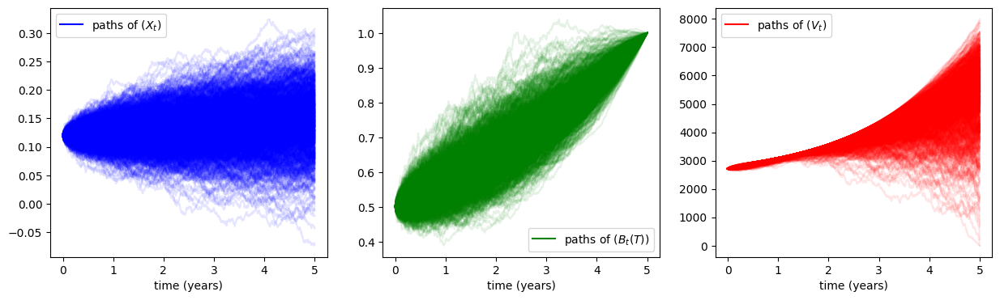

In [117]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))
axs[0].plot(time_grid, rf_paths.T[:, :1000], alpha=0.1, color='blue')
axs[0].plot([None], [None], color='blue', label='paths of $(X_t)$')
axs[0].set_xlabel('time (years)')
axs[0].legend()
axs[1].plot(time_grid, zc1_mtm_paths.T[:, :1000], alpha=0.1, color='green')
axs[1].plot([None], [None], color='green', label='paths of $(B_t(T))$')
axs[1].set_xlabel('time (years)')
axs[1].legend()
axs[2].plot(time_grid, swaption_mtm_paths.T[:, :1000], alpha=0.1, color='red')
axs[2].plot([None], [None], color='red', label='paths of $(V_t)$')
axs[2].set_xlabel('time (years)')
axs[2].legend()
plt.show()

In [118]:
rt_vals = np.linspace(-0.2, 0.2, 1000)
rt_vals_full = np.repeat(rt_vals.reshape(-1, 1), len(time_grid), axis=1)
swaption_mtm = utils.gen_mtm(rt_vals_full, k, sigma, R, C1, C2, C3, dt, T, time_grid, fixing_grid, notional)

In [119]:
def mean(t):
    return r0 * np.exp(-k*t) + utils.beta(t, k, sigma, C1, C2, C3) - utils.beta(0, k, sigma, C1, C2, C3) * np.exp(-k*t)

def variance(t):
    return (sigma**2 / (2*k)) * (1 - np.exp(-2*k*t))

pdf_vals = norm.pdf(rt_vals, loc=mean(time_grid).reshape(-1, 1), scale=np.sqrt(variance(time_grid)).reshape(-1, 1)).T
pdf_vals[:, 0] = 0

c:\Users\CF518AW\OneDrive - EY\Documents\STAGE\EY-Initial-Margin\.venv\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2046: RuntimeWarning: divide by zero encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


In [120]:
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
u = ax.plot(rt_vals, swaption_mtm[:, 0], label='$u(t, r)$')[0]
v = ax.plot(rt_vals, pdf_vals[:, 0], label='pdf of $r_t$')[0]
rtime_grid = time_grid[::2]
rswaption_mtm = swaption_mtm[:, ::2]
rpdf_vals = pdf_vals[:, ::2] * 10
ax.set_title(f"t = {rtime_grid[0]:.2f}")
ax.grid()
ax.set_xlabel("$r$")
ax.set_ylim(np.min(rswaption_mtm), np.max(rswaption_mtm))

def update(n):
    u.set_ydata(rswaption_mtm[:, n])
    v.set_ydata(rpdf_vals[:, n] * 10)
    ax.set_title(f"t = {rtime_grid[n]:.2f}")
    return [u]

video = animation.FuncAnimation(fig, update, frames=len(rtime_grid), blit=True, interval=100, repeat=False)
plt.close(fig)
HTML(video.to_jshtml())

In [121]:
mean(time_grid)

array([0.12      , 0.1200225 , 0.12004499, ..., 0.14501274, 0.14503352,
       0.1450543 ], shape=(1201,))

In [122]:
Zi_vals = np.linspace(-4, 4, 1000)

rt_vals = np.linspace(-0.5, 0.5, 100)
for rt in tqdm(rt_vals):
    rtdelta_vals = (rt - utils.beta(time_grid[:-ind_delta], k, sigma, C1, C2, C3)) * exp(-k*dt) + utils.beta(time_grid[ind_delta:], k, sigma, C1, C2, C3) + sqrt(sigma**2/(2*k) * (1 - exp(-2*k*dt))) * Zi_vals.reshape(-1, 1)
    #rtdelta_vals = np.concatenate((rt*np.ones((len(Zi_vals), 1)), rtdelta_vals), axis=1)
    swaption_mtm = utils.gen_mtm(rtdelta_vals, k, sigma, R, C1, C2, C3, dt, T, time_grid[ind_delta:], fixing_grid, notional)
    #time_gridtrunc = time_grid[:-ind_delta]
    diff_swaption_mtm = np.diff(swaption_mtm, axis=0)[:, 1:]
    res = np.logical_or(np.all(diff_swaption_mtm < 0, axis=0), np.all(diff_swaption_mtm > 0, axis=0))
    resbis = np.all(np.all(diff_swaption_mtm < 0, axis=0)) or np.all(np.all(diff_swaption_mtm > 0, axis=0))
    if not np.all(res):
        print(f'It is not strictly monotonic for all t')
    else:
        if not np.all(resbis):
            print(f'It is strictly monotonic for all t, but not of the same monotonicity')

  1%|          | 1/100 [00:07<11:49,  7.16s/it]

It is not strictly monotonic for all t


  2%|▏         | 2/100 [00:14<11:44,  7.19s/it]

It is not strictly monotonic for all t


  3%|▎         | 3/100 [00:22<12:14,  7.58s/it]

It is not strictly monotonic for all t


  4%|▍         | 4/100 [00:31<12:49,  8.01s/it]

It is not strictly monotonic for all t


  5%|▌         | 5/100 [00:39<12:37,  7.98s/it]

It is not strictly monotonic for all t


  6%|▌         | 6/100 [00:47<12:43,  8.13s/it]

It is not strictly monotonic for all t


  7%|▋         | 7/100 [00:56<13:17,  8.58s/it]

It is not strictly monotonic for all t


  8%|▊         | 8/100 [01:07<13:57,  9.11s/it]

It is not strictly monotonic for all t


  9%|▉         | 9/100 [01:15<13:29,  8.90s/it]

It is not strictly monotonic for all t


 10%|█         | 10/100 [01:23<12:45,  8.51s/it]

It is not strictly monotonic for all t


 11%|█         | 11/100 [01:32<12:47,  8.62s/it]

It is not strictly monotonic for all t


 12%|█▏        | 12/100 [01:43<13:42,  9.35s/it]

It is not strictly monotonic for all t


 13%|█▎        | 13/100 [01:53<14:11,  9.78s/it]

It is not strictly monotonic for all t


 14%|█▍        | 14/100 [02:04<14:28, 10.10s/it]

It is not strictly monotonic for all t


 15%|█▌        | 15/100 [02:13<13:52,  9.80s/it]

It is not strictly monotonic for all t


 16%|█▌        | 16/100 [02:22<13:04,  9.34s/it]

It is not strictly monotonic for all t


 17%|█▋        | 17/100 [02:30<12:21,  8.94s/it]

It is not strictly monotonic for all t


 18%|█▊        | 18/100 [02:38<11:48,  8.64s/it]

It is not strictly monotonic for all t


 19%|█▉        | 19/100 [02:47<11:48,  8.75s/it]

It is not strictly monotonic for all t


 20%|██        | 20/100 [02:55<11:26,  8.58s/it]

It is not strictly monotonic for all t


 21%|██        | 21/100 [03:03<11:10,  8.49s/it]

It is not strictly monotonic for all t


 22%|██▏       | 22/100 [03:11<10:57,  8.42s/it]

It is not strictly monotonic for all t


 23%|██▎       | 23/100 [03:21<11:09,  8.70s/it]

It is not strictly monotonic for all t


 24%|██▍       | 24/100 [03:30<11:05,  8.76s/it]

It is not strictly monotonic for all t


 25%|██▌       | 25/100 [03:38<10:40,  8.54s/it]

It is not strictly monotonic for all t


 26%|██▌       | 26/100 [03:45<09:58,  8.09s/it]

It is not strictly monotonic for all t


 27%|██▋       | 27/100 [03:52<09:30,  7.82s/it]

It is not strictly monotonic for all t


 28%|██▊       | 28/100 [03:59<09:19,  7.78s/it]

It is not strictly monotonic for all t


 29%|██▉       | 29/100 [04:07<09:03,  7.65s/it]

It is not strictly monotonic for all t


 30%|███       | 30/100 [04:14<08:50,  7.59s/it]

It is not strictly monotonic for all t


 31%|███       | 31/100 [04:20<08:07,  7.07s/it]

It is not strictly monotonic for all t


 32%|███▏      | 32/100 [04:26<07:40,  6.77s/it]

It is not strictly monotonic for all t


 33%|███▎      | 33/100 [04:32<07:17,  6.53s/it]

It is not strictly monotonic for all t


 34%|███▍      | 34/100 [04:38<06:53,  6.27s/it]

It is not strictly monotonic for all t


 35%|███▌      | 35/100 [04:44<06:35,  6.09s/it]

It is not strictly monotonic for all t


 36%|███▌      | 36/100 [04:49<06:24,  6.00s/it]

It is not strictly monotonic for all t


 37%|███▋      | 37/100 [04:55<06:11,  5.90s/it]

It is not strictly monotonic for all t


 38%|███▊      | 38/100 [05:01<06:10,  5.97s/it]

It is not strictly monotonic for all t


 39%|███▉      | 39/100 [05:07<06:10,  6.07s/it]

It is not strictly monotonic for all t


 40%|████      | 40/100 [05:14<06:12,  6.21s/it]

It is not strictly monotonic for all t


 41%|████      | 41/100 [05:21<06:13,  6.33s/it]

It is not strictly monotonic for all t


 42%|████▏     | 42/100 [05:27<06:17,  6.51s/it]

It is not strictly monotonic for all t


 43%|████▎     | 43/100 [05:34<06:18,  6.64s/it]

It is not strictly monotonic for all t


 44%|████▍     | 44/100 [05:41<06:15,  6.70s/it]

It is not strictly monotonic for all t


 57%|█████▋    | 57/100 [07:17<05:12,  7.26s/it]

It is not strictly monotonic for all t


 58%|█████▊    | 58/100 [07:24<05:02,  7.20s/it]

It is not strictly monotonic for all t


 59%|█████▉    | 59/100 [07:33<05:10,  7.58s/it]

It is not strictly monotonic for all t


 60%|██████    | 60/100 [07:41<05:14,  7.86s/it]

It is not strictly monotonic for all t


 61%|██████    | 61/100 [07:51<05:30,  8.48s/it]

It is not strictly monotonic for all t


 62%|██████▏   | 62/100 [08:00<05:31,  8.71s/it]

It is not strictly monotonic for all t


 63%|██████▎   | 63/100 [08:09<05:23,  8.75s/it]

It is not strictly monotonic for all t


 64%|██████▍   | 64/100 [08:19<05:23,  9.00s/it]

It is not strictly monotonic for all t


 65%|██████▌   | 65/100 [08:30<05:38,  9.66s/it]

It is not strictly monotonic for all t


 66%|██████▌   | 66/100 [08:41<05:37,  9.94s/it]

It is not strictly monotonic for all t


 67%|██████▋   | 67/100 [08:50<05:26,  9.90s/it]

It is not strictly monotonic for all t


 68%|██████▊   | 68/100 [09:00<05:08,  9.65s/it]

It is not strictly monotonic for all t


 69%|██████▉   | 69/100 [09:09<05:00,  9.70s/it]

It is not strictly monotonic for all t


 70%|███████   | 70/100 [09:18<04:43,  9.44s/it]

It is not strictly monotonic for all t


 71%|███████   | 71/100 [09:26<04:23,  9.09s/it]

It is not strictly monotonic for all t


 72%|███████▏  | 72/100 [09:43<05:18, 11.37s/it]

It is not strictly monotonic for all t


 73%|███████▎  | 73/100 [09:53<04:56, 10.99s/it]

It is not strictly monotonic for all t


 74%|███████▍  | 74/100 [10:04<04:42, 10.86s/it]

It is not strictly monotonic for all t


 75%|███████▌  | 75/100 [10:12<04:10, 10.01s/it]

It is not strictly monotonic for all t


 76%|███████▌  | 76/100 [10:21<03:50,  9.60s/it]

It is not strictly monotonic for all t


 77%|███████▋  | 77/100 [10:32<03:51, 10.07s/it]

It is not strictly monotonic for all t


 78%|███████▊  | 78/100 [10:42<03:41, 10.09s/it]

It is not strictly monotonic for all t


 79%|███████▉  | 79/100 [10:52<03:31, 10.06s/it]

It is not strictly monotonic for all t


 80%|████████  | 80/100 [11:01<03:18,  9.92s/it]

It is not strictly monotonic for all t


 81%|████████  | 81/100 [11:12<03:11, 10.10s/it]

It is not strictly monotonic for all t


 82%|████████▏ | 82/100 [11:29<03:38, 12.15s/it]

It is not strictly monotonic for all t


 83%|████████▎ | 83/100 [11:42<03:30, 12.39s/it]

It is not strictly monotonic for all t


 84%|████████▍ | 84/100 [11:58<03:35, 13.47s/it]

It is not strictly monotonic for all t


 85%|████████▌ | 85/100 [12:14<03:35, 14.34s/it]

It is not strictly monotonic for all t


 86%|████████▌ | 86/100 [12:30<03:26, 14.73s/it]

It is not strictly monotonic for all t


 87%|████████▋ | 87/100 [12:42<03:00, 13.90s/it]

It is not strictly monotonic for all t


 88%|████████▊ | 88/100 [12:52<02:33, 12.79s/it]

It is not strictly monotonic for all t


 89%|████████▉ | 89/100 [13:02<02:11, 11.92s/it]

It is not strictly monotonic for all t


 90%|█████████ | 90/100 [13:12<01:52, 11.29s/it]

It is not strictly monotonic for all t


 91%|█████████ | 91/100 [13:28<01:55, 12.80s/it]

It is not strictly monotonic for all t


 92%|█████████▏| 92/100 [13:40<01:40, 12.53s/it]

It is not strictly monotonic for all t


 93%|█████████▎| 93/100 [13:50<01:22, 11.85s/it]

It is not strictly monotonic for all t


 94%|█████████▍| 94/100 [13:58<01:04, 10.75s/it]

It is not strictly monotonic for all t


 95%|█████████▌| 95/100 [14:06<00:49,  9.95s/it]

It is not strictly monotonic for all t


 96%|█████████▌| 96/100 [14:17<00:40, 10.07s/it]

It is not strictly monotonic for all t


 97%|█████████▋| 97/100 [14:25<00:28,  9.40s/it]

It is not strictly monotonic for all t


 98%|█████████▊| 98/100 [14:34<00:18,  9.39s/it]

It is not strictly monotonic for all t


 99%|█████████▉| 99/100 [14:48<00:10, 10.92s/it]

It is not strictly monotonic for all t


100%|██████████| 100/100 [15:07<00:00,  9.07s/it]

It is not strictly monotonic for all t


In [123]:
rt_vals[40]

np.float64(-0.09595959595959591)

In [124]:
rt = rt_vals[40]
rtdelta_vals = (rt - utils.beta(time_grid[:-1], k, sigma, C1, C2, C3)) * exp(-k*delta) + utils.beta(time_grid[1:], k, sigma, C1, C2, C3) + sqrt(sigma**2/(2*k) * (1 - exp(-2*k*delta))) * Zi_vals.reshape(-1, 1)
rtdelta_vals = np.concatenate((rt*np.ones((len(Zi_vals), 1)), rtdelta_vals), axis=1)
swaption_mtm = utils.gen_mtm(rtdelta_vals, k, sigma, R, C1, C2, C3, dt, T, time_grid+delta, fixing_grid, notional)[:, :-ind_delta]
time_gridtrunc = time_grid[:-ind_delta]
diff_swaption_mtm = np.diff(swaption_mtm, axis=0)[:, 1:]
res = np.logical_or(np.all(diff_swaption_mtm < 0, axis=0), np.all(diff_swaption_mtm > 0, axis=0))
resbis = np.all(np.all(diff_swaption_mtm < 0, axis=0)) or np.all(np.all(diff_swaption_mtm > 0, axis=0))

if not np.all(res):
    print(f'It is not strictly monotonic for all t')
else:
    if not np.all(resbis):
        print(f'It is strictly monotonic for all t, but not of the same monotonicity')

c:\Users\CF518AW\OneDrive - EY\Documents\STAGE\EY-Initial-Margin\least_squares_mc\utils.py:65: RuntimeWarning: invalid value encountered in sqrt
  return sigma/k * (1 -exp(-k*(S-T))) * np.sqrt((1 - np.exp(-2*k*(T-t)))/(2*k))


It is not strictly monotonic for all t


In [125]:
res.shape

(1190,)

In [126]:
np.where(res == False)[0]

array([1189])

In [127]:
time_grid.shape

(1201,)

In [128]:
time_grid[ind_check]

np.float64(4.954166666666667)

In [129]:
swaption_mtm

array([[1.78869008e+03, 1.55810996e+03, 1.55664835e+03, ...,
        4.60230976e-02, 2.24182734e-02, 0.00000000e+00],
       [1.78869008e+03, 1.55857379e+03, 1.55711232e+03, ...,
        4.61360960e-02, 2.24599944e-02, 0.00000000e+00],
       [1.78869008e+03, 1.55903763e+03, 1.55757630e+03, ...,
        4.62495898e-02, 2.25018104e-02, 0.00000000e+00],
       ...,
       [1.78869008e+03, 2.01213675e+03, 2.01093916e+03, ...,
        5.26862489e+00, 1.30630155e+00, 0.00000000e+00],
       [1.78869008e+03, 2.01257239e+03, 2.01137519e+03, ...,
        5.29586103e+00, 1.31485517e+00, 0.00000000e+00],
       [1.78869008e+03, 2.01300797e+03, 2.01181116e+03, ...,
        5.32322569e+00, 1.32346343e+00, 0.00000000e+00]],
      shape=(1000, 1191))

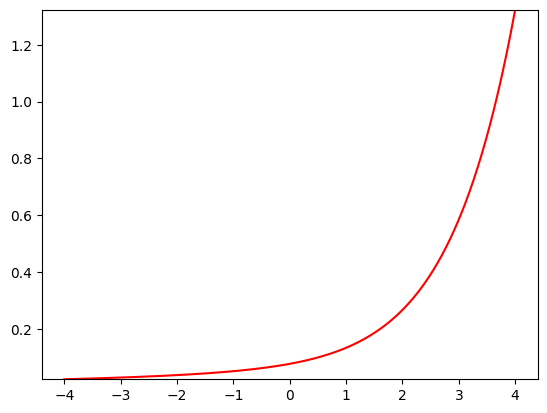

In [130]:
ind_check = 1189
plt.plot(Zi_vals, swaption_mtm[:, ind_check], color='red')
plt.ylim(0.99999 * np.min(swaption_mtm[:, ind_check]), 1.00001 * np.max(swaption_mtm[:, ind_check]))
plt.show()

In [131]:
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
u = ax.plot(Zi_vals, swaption_mtm[:, 0], label='$g(t, z)$')[0]
rtime_grid = time_gridtrunc[::2]
rswaption_mtm = swaption_mtm[:, ::2]
ax.set_title(f"t = {rtime_grid[0]:.2f}")
ax.grid()
ax.set_xlabel("$r$")
ax.set_ylim(np.min(rswaption_mtm), np.max(rswaption_mtm))
#ax.set_ylim(3100, 3150)

def update(n):
    u.set_ydata(rswaption_mtm[:, n])
    ax.set_title(f"t = {rtime_grid[n]:.2f}")
    return [u]

video = animation.FuncAnimation(fig, update, frames=len(rtime_grid), blit=True, interval=100, repeat=False)
plt.close(fig)
HTML(video.to_jshtml())